In [73]:
def abs_sobel_thresh(image, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Calculate directional gradient
    # Apply threshold
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    # Calculate the derivative in the x-direction (the 1, 0 at the end denotes x-direction):
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    #Calculate the derivative in the y-direction (the 0, 1 at the end denotes y-direction):
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    #Calculate the absolute value of the x-derivative:

    if(orient == 'x'):
        sobel = sobelx
    else:
        sobel = sobely
        
    abs_sobel = np.absolute(sobel)
    #Convert the absolute value image to 8-bit:
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))

    thresh_min = thresh[0]
    thresh_max = thresh[1]
    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    
    plt.imshow(grad_binary, cmap='gray')
    return grad_binary

In [76]:
def mag_thresh(image, sobel_kernel=3, mag_thresh=(20, 100)):
    # Calculate gradient magnitude
    # Apply threshold
    thresh_min = mag_thresh[0]
    thresh_max = mag_thresh[1]
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    sobelxy = np.sqrt(sobelx**2 + sobely**2)
    abs_sobelxy = np.absolute(sobelxy)
    scaled_sobel = np.uint8(255*abs_sobelxy/np.max(abs_sobelxy))
    mag_binary = np.zeros_like(scaled_sobel)
    mag_binary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    return mag_binary

In [28]:
def dir_threshold(image, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Calculate gradient direction
    # Apply threshold
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    direction = np.arctan2(abs_sobely,abs_sobelx)
    scaled_sobel = np.uint8(255*direction/np.max(direction))
    dir_binary = np.zeros_like(scaled_sobel)
    dir_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return dir_binary

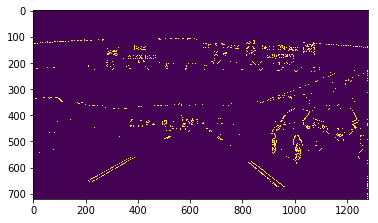

In [129]:
import cv2
from matplotlib import pyplot as plt
import matplotlib.image as mpimg
import numpy as np

# Load image
image = mpimg.imread('../CV/signs_vehicles_xygrad.png')

# Choose a Sobel kernel size
ksize = 3 # Choose a larger odd number to smooth gradient measurements

# Apply each of the thresholding functions
gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(30, 255))
grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(15, 200))
mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(90, 150))
dir_binary = dir_threshold(image, sobel_kernel=7, thresh=(0, np.pi*2))

combined = np.zeros_like(dir_binary)
combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1

plt.imshow(combined)
plt.show()

In [130]:
mpimg. imshow(dir_binary)
plt.figure()
plt.imshow(gradx)
plt.figure()
plt.imshow(grady)
plt.figure()
plt.imshow(mag_binary)
plt.show()

AttributeError: module 'matplotlib.image' has no attribute 'imshow'

# HLS

/home/alex/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


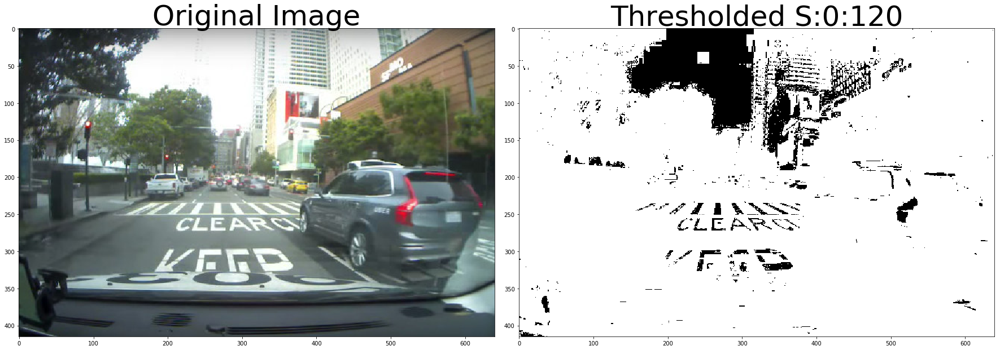

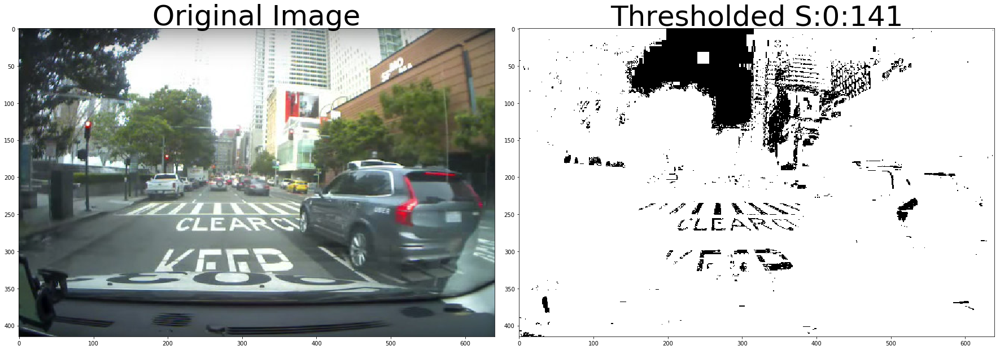

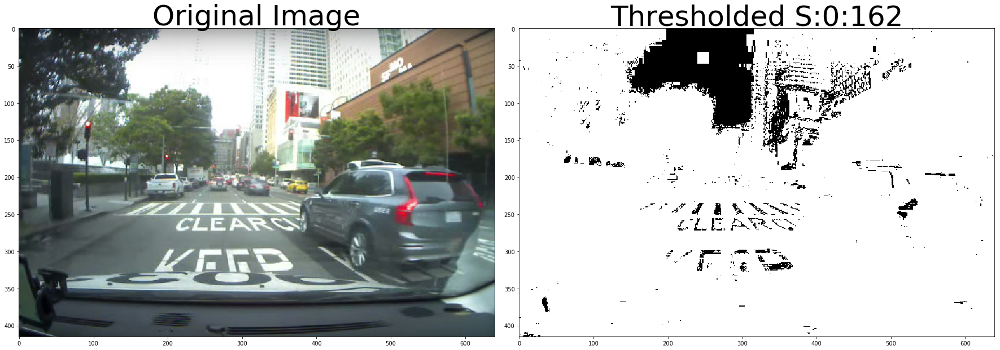

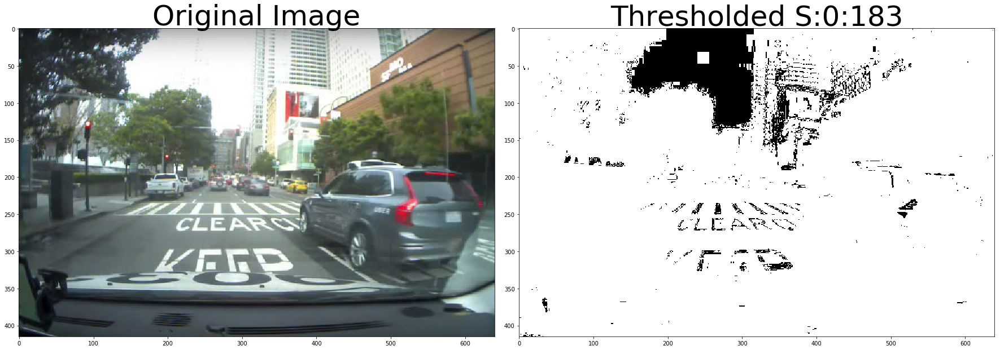

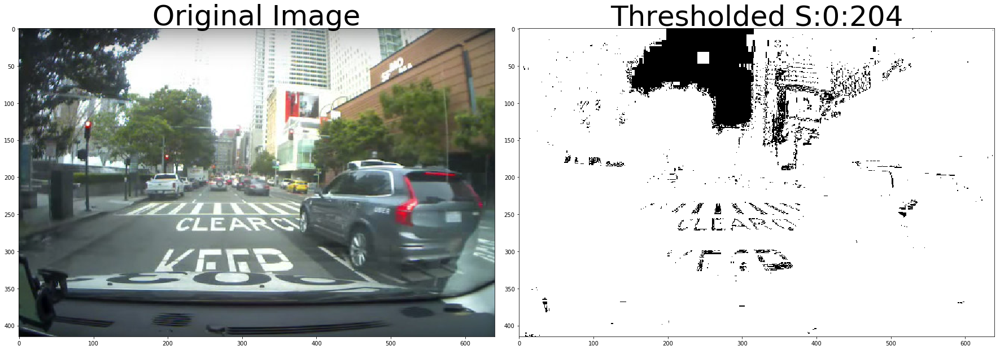

...

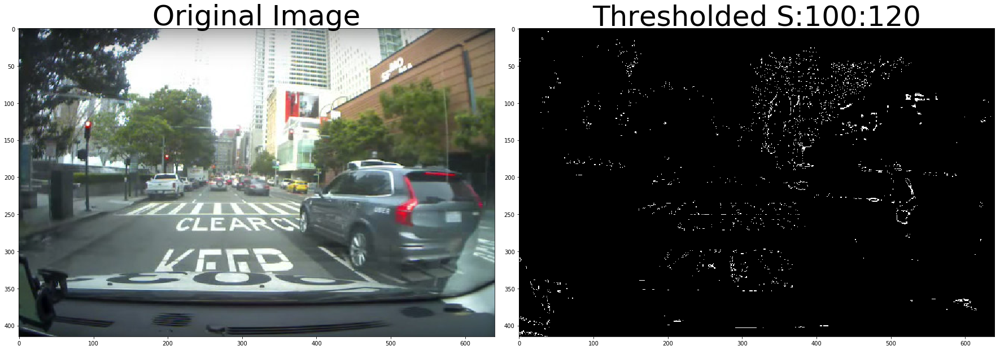

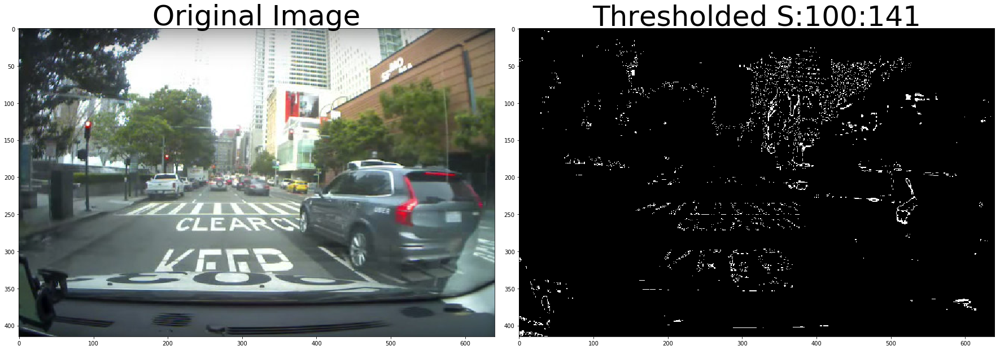

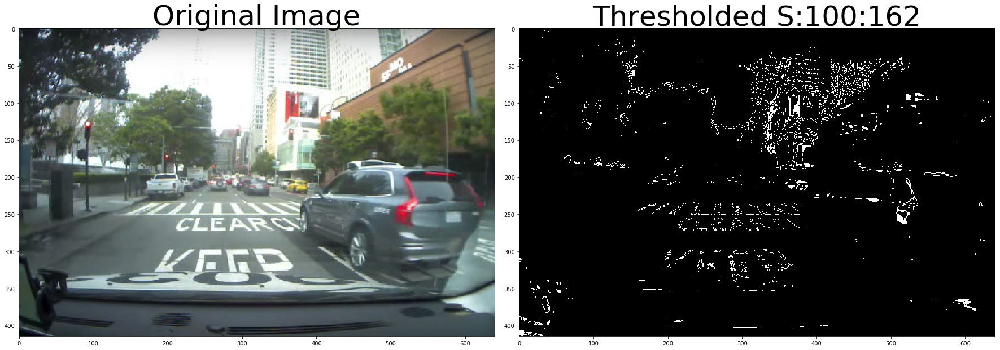

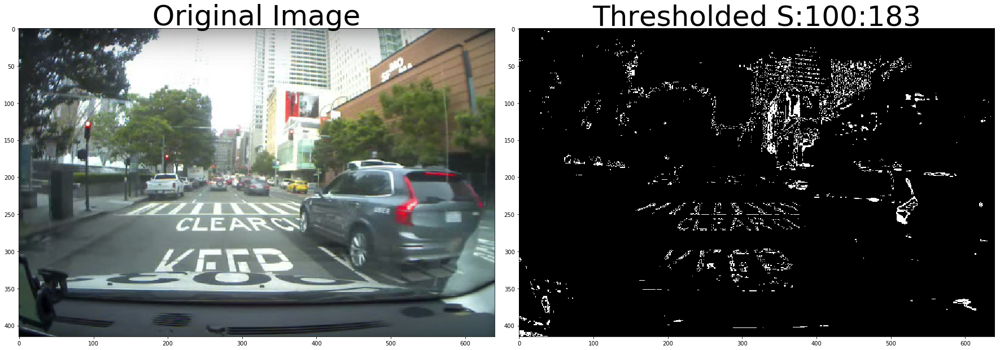

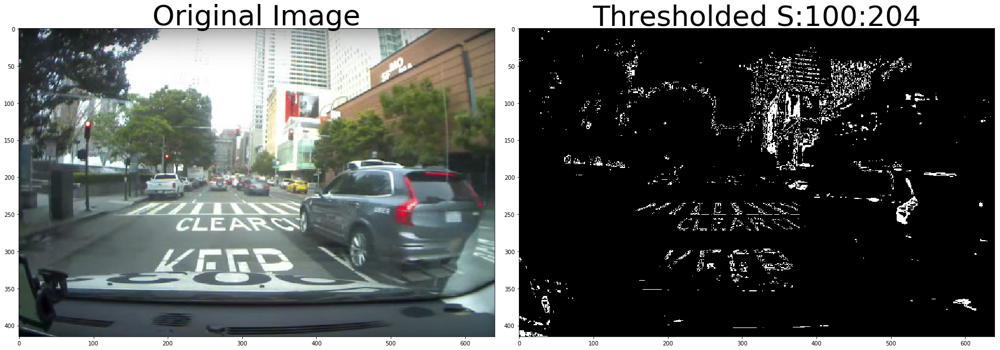

In [144]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
from itertools import product
%matplotlib inline

# Read in an image, you can also try test1.jpg or test4.jpg
#image = mpimg.imread('test6.jpg') 
image = mpimg.imread('../CV/test6.jpg') 
# Define a function that thresholds the S-channel of HLS
# Use exclusive lower bound (>) and inclusive upper (<=)
def hls_select(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(image, cv2.COLOR_BGR2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    # 2) Apply a threshold to the S channel
    binary = np.zeros_like(S)
    binary[(S > thresh[0]) & (S <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    return binary
    


# Plot the result
lowers = [0,20,40,60,80,100]
uppers = [120,141,162,183,204]
for (low,high) in product(lowers,uppers):
    hls_binary = hls_select(image, thresh=(low,high))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(hls_binary, cmap='gray')
    ax2.set_title('Thresholded S:%d:%d' % (low,high), fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)